In [1]:
import librosa
import os
import numpy as np
import matplotlib.pyplot as plt
import random
import pandas as pd
import IPython.display as ipd
import soundfile
from librosa.util import frame, abs2

## (1) EDA

### (a) Loading the data and finding summary of amplitude and duration of the data

In [2]:
data_path = 'data'

In [3]:
# # remove all clean files
# for class_ in os.listdir(data_path):
#     if class_ == '_background_noise_':
#         continue
#     class_path = os.path.join(data_path, class_)
#     for file in os.listdir(class_path):
#         if file.startswith('clean_'):
#             os.remove(os.path.join(class_path, file))

In [4]:
def get_amplitude(file_path):
    y, sr = librosa.load(file_path, sr=None)
    return y, sr

In [10]:
def calc_stats(path):

    statistics = []

    for class_ in os.listdir(path):
        if class_ == '_background_noise_':
            continue
        class_path = os.path.join(path, class_)
        for file in os.listdir(class_path):
            if file.endswith('.wav'):
                file_path = os.path.join(class_path, file)
                y, sr = get_amplitude(file_path)
                duration = librosa.get_duration(y=y, sr=sr)
    
                stats = {
                    'file': file,
                    'class': class_,
                    'duration': duration,
                    'mean amplitude': np.mean(y),
                    'max amplitude': np.max(y),
                    'min amplitude': np.min(y),
                    'std amplitude': np.std(y),
                }

                statistics.append(stats)

    return statistics

In [6]:
stats = calc_stats(data_path)


In [9]:
print (stats)

[{'file': '0165e0e8_nohash_0.wav', 'class': 'backward', 'duration': 1.0, 'mean amplitude': -0.07735643, 'max amplitude': 0.71429443, 'min amplitude': -0.9489441, 'std amplitude': 0.07248766}, {'file': '017c4098_nohash_0.wav', 'class': 'backward', 'duration': 1.0, 'mean amplitude': -5.6625366e-05, 'max amplitude': 0.84054565, 'min amplitude': -0.809021, 'std amplitude': 0.097710446}, {'file': '017c4098_nohash_1.wav', 'class': 'backward', 'duration': 1.0, 'mean amplitude': 1.0856628e-05, 'max amplitude': 0.65826416, 'min amplitude': -0.565155, 'std amplitude': 0.07076168}, {'file': '017c4098_nohash_2.wav', 'class': 'backward', 'duration': 1.0, 'mean amplitude': 1.40609745e-05, 'max amplitude': 0.7999878, 'min amplitude': -0.7532959, 'std amplitude': 0.086517796}, {'file': '017c4098_nohash_3.wav', 'class': 'backward', 'duration': 1.0, 'mean amplitude': 6.946373e-05, 'max amplitude': 0.82022095, 'min amplitude': -0.64746094, 'std amplitude': 0.09603348}, {'file': '017c4098_nohash_4.wav', '

In [11]:
df_stats = pd.DataFrame(stats)

print(df_stats)

                         file     class  duration  mean amplitude  \
0       0165e0e8_nohash_0.wav  backward       1.0       -0.077356   
1       017c4098_nohash_0.wav  backward       1.0       -0.000057   
2       017c4098_nohash_1.wav  backward       1.0        0.000011   
3       017c4098_nohash_2.wav  backward       1.0        0.000014   
4       017c4098_nohash_3.wav  backward       1.0        0.000069   
...                       ...       ...       ...             ...   
105824  ffd2ba2f_nohash_1.wav      zero       1.0        0.000101   
105825  ffd2ba2f_nohash_2.wav      zero       1.0        0.000206   
105826  ffd2ba2f_nohash_3.wav      zero       1.0        0.000071   
105827  ffd2ba2f_nohash_4.wav      zero       1.0        0.000038   
105828  fffcabd1_nohash_0.wav      zero       1.0        0.000002   

        max amplitude  min amplitude  std amplitude  
0            0.714294      -0.948944       0.072488  
1            0.840546      -0.809021       0.097710  
2        

In [13]:
df_stats.sort_values(by='class', inplace=True)
df_stats.reset_index(drop=True, inplace=True)
df_stats

,file,class,duration,mean amplitude,max amplitude,min amplitude,std amplitude
0,0165e0e8_nohash_0.wav,backward,1.0,-0.077356,0.714294,-0.948944,0.072488
1,87070229_nohash_2.wav,backward,1.0,0.000090,0.496307,-0.874329,0.053556
2,017c4098_nohash_0.wav,backward,1.0,-0.000057,0.840546,-0.809021,0.097710
3,017c4098_nohash_1.wav,backward,1.0,0.000011,0.658264,-0.565155,0.070762
4,017c4098_nohash_2.wav,backward,1.0,0.000014,0.799988,-0.753296,0.086518
...,...,...,...,...,...,...,...
105824,837a0f64_nohash_3.wav,zero,1.0,0.000087,0.447327,-0.678070,0.085159
105825,ffd2ba2f_nohash_2.wav,zero,1.0,0.000206,0.191864,-0.271790,0.050935
105826,ffd2ba2f_nohash_3.wav,zero,1.0,0.000071,0.212341,-0.283813,0.046812
105827,ff4ed4f3_nohash_0.wav,zero,1.0,0.000052,0.834381,-0.919952,0.104592


In [15]:
amplitude = df_stats.groupby('class').agg({
    'mean amplitude' : ['min', 'max', 'mean', 'std'],
    'max amplitude' : ['min', 'max', 'mean', 'std'],
    'min amplitude' : ['min', 'max', 'mean', 'std'],
    'std amplitude' : ['min', 'max', 'mean', 'std']
})

# print(amplitude)

In [16]:
duration = df_stats.groupby('class').agg({
    'duration' : ['min', 'max', 'mean', 'std']
})

# print(duration)

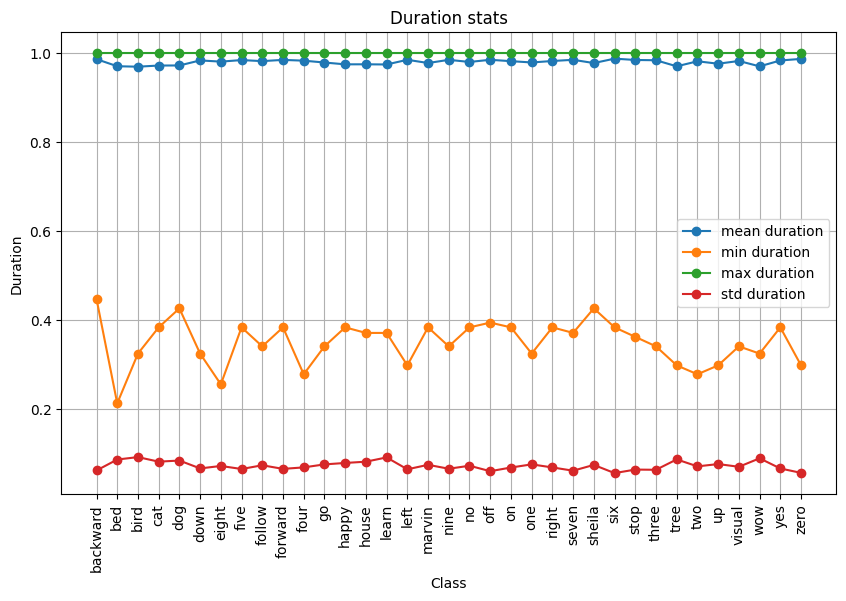

In [17]:
# Plotting durations stats
plt.figure(figsize=(10, 6))
plt.plot(duration['duration']['mean'], 'o-', label='mean duration')
plt.plot(duration['duration']['min'], 'o-', label='min duration')
plt.plot(duration['duration']['max'], 'o-', label='max duration')
plt.plot(duration['duration']['std'], 'o-', label='std duration')
plt.title('Duration stats')
plt.xlabel('Class')
plt.ylabel('Duration')

plt.legend()
plt.xticks(rotation=90)
plt.grid()
plt.show()

We observe that the mean and max duration are same for all the classes. This is because the data is sampled at 16kHz and the duration is 1 second.

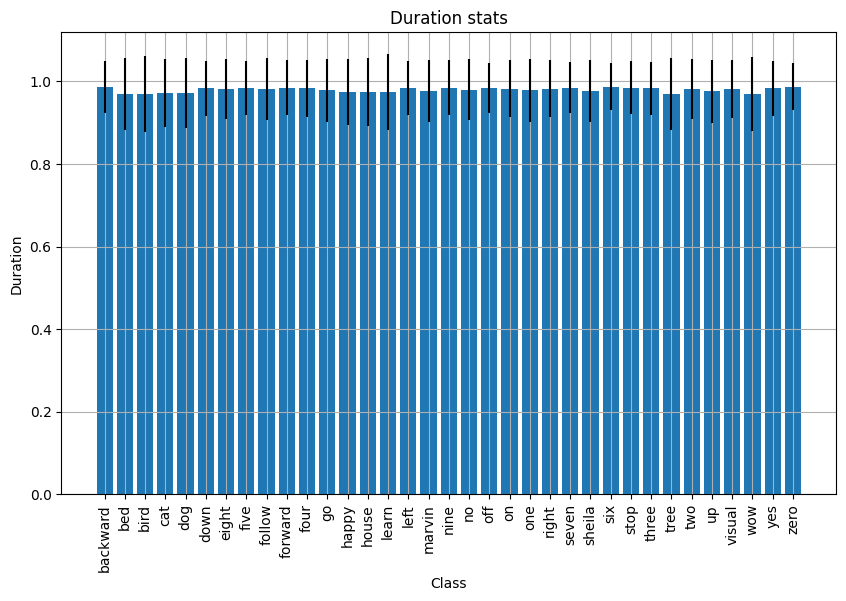

In [18]:
plt.figure(figsize=(10, 6))
plt.bar(duration.index, duration['duration']['mean'], yerr=duration['duration']['std'])
plt.title('Duration stats')
plt.xlabel('Class')
plt.ylabel('Duration')
plt.xticks(rotation=90)
plt.grid()
plt.show()

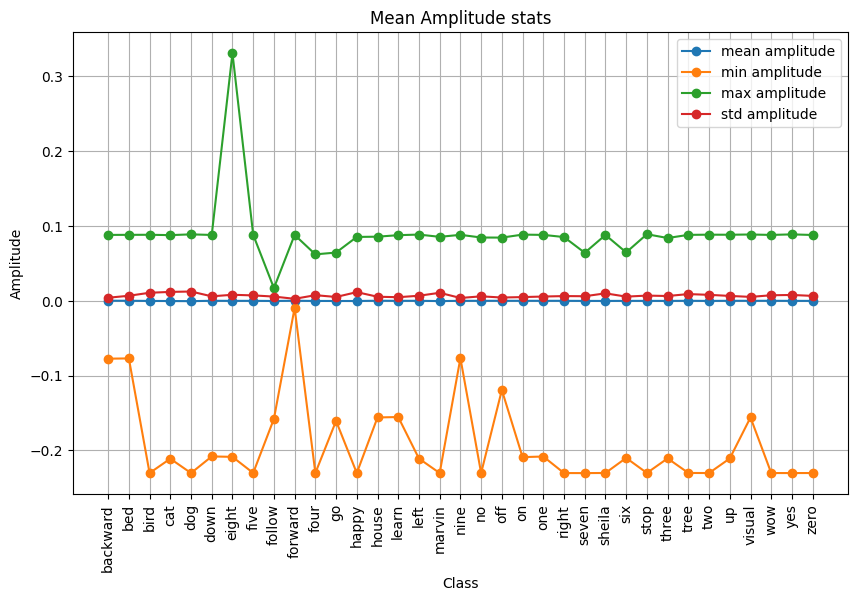

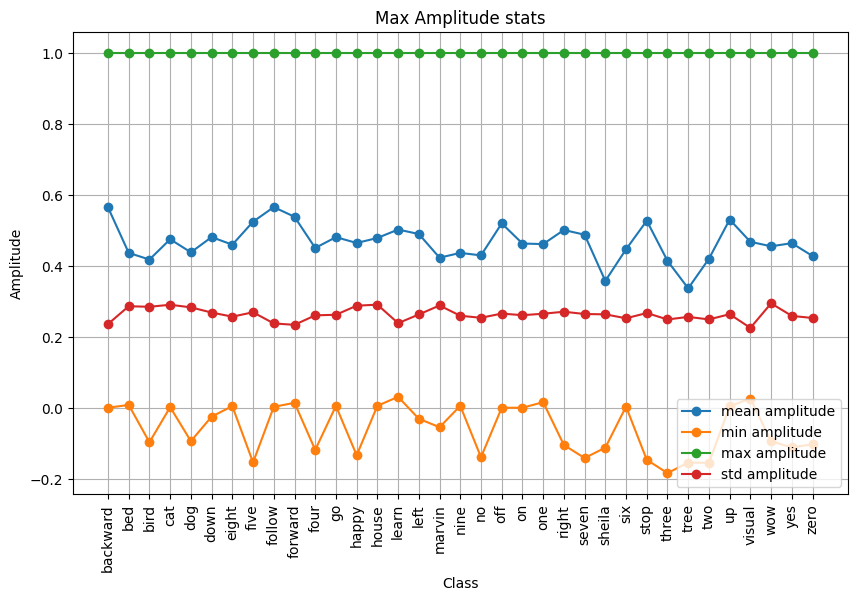

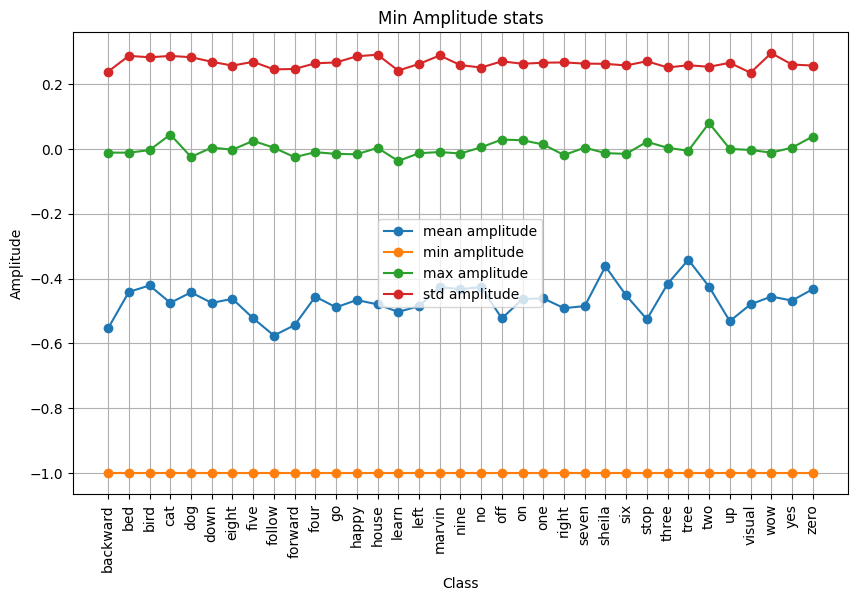

In [19]:
# Plotting amplitude stats
plt.figure(figsize=(10, 6))
plt.plot(amplitude['mean amplitude']['mean'], 'o-', label='mean amplitude')
plt.plot(amplitude['mean amplitude']['min'], 'o-', label='min amplitude')
plt.plot(amplitude['mean amplitude']['max'], 'o-', label='max amplitude')
plt.plot(amplitude['mean amplitude']['std'], 'o-', label='std amplitude')
plt.title('Mean Amplitude stats')
plt.xlabel('Class')
plt.ylabel('Amplitude')

plt.legend()
plt.xticks(rotation=90)
plt.grid()

plt.figure(figsize=(10, 6))
plt.plot(amplitude['max amplitude']['mean'], 'o-', label='mean amplitude')
plt.plot(amplitude['max amplitude']['min'], 'o-', label='min amplitude')
plt.plot(amplitude['max amplitude']['max'], 'o-', label='max amplitude')
plt.plot(amplitude['max amplitude']['std'], 'o-', label='std amplitude')
plt.title('Max Amplitude stats')
plt.xlabel('Class')
plt.ylabel('Amplitude')

plt.legend()
plt.xticks(rotation=90)
plt.grid()

plt.figure(figsize=(10, 6))
plt.plot(amplitude['min amplitude']['mean'], 'o-', label='mean amplitude')
plt.plot(amplitude['min amplitude']['min'], 'o-', label='min amplitude')
plt.plot(amplitude['min amplitude']['max'], 'o-', label='max amplitude')
plt.plot(amplitude['min amplitude']['std'], 'o-', label='std amplitude')
plt.title('Min Amplitude stats')
plt.xlabel('Class')
plt.ylabel('Amplitude')

plt.legend()
plt.xticks(rotation=90)
plt.grid()
plt.show()

We observe huge veriations in the amplitude of the data. This was bound to happen since some samples might contain noise, some may contain silences and different words might be spoken at different amplitudes.

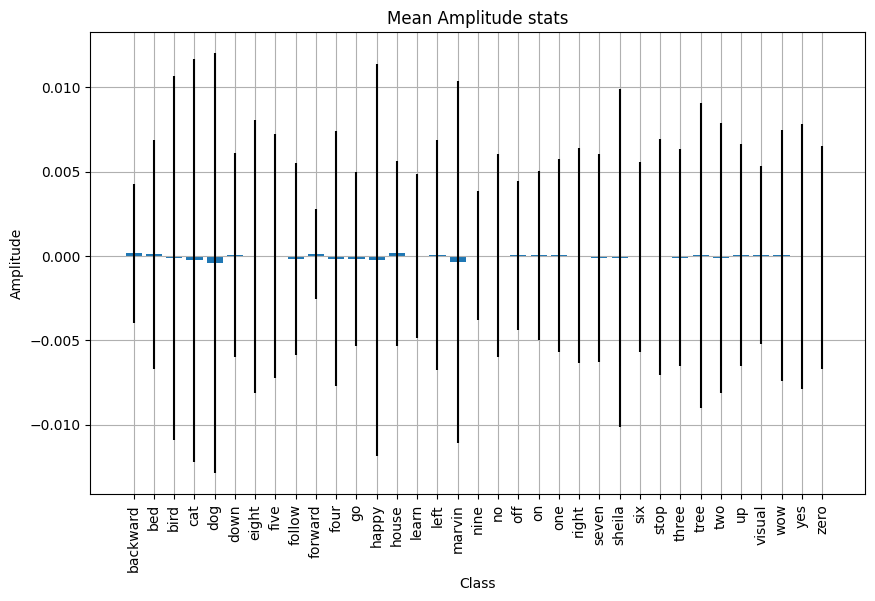

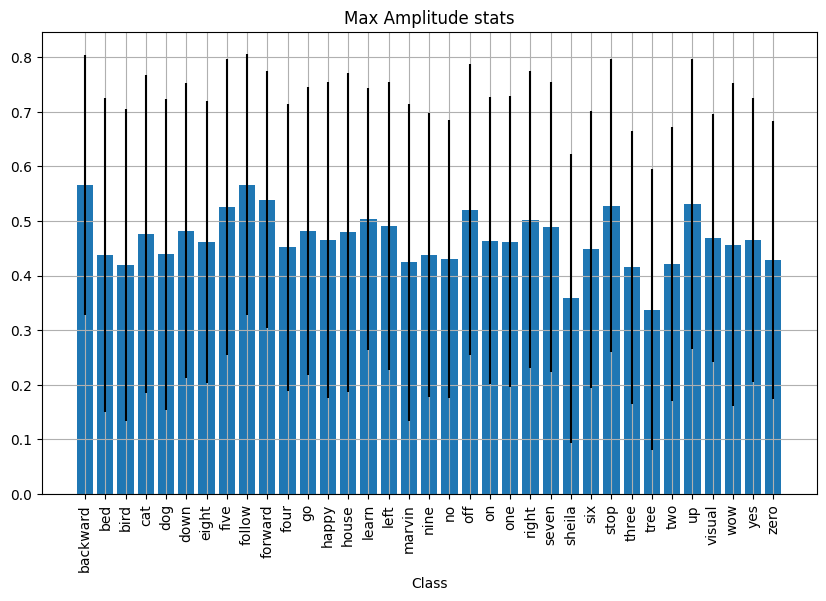

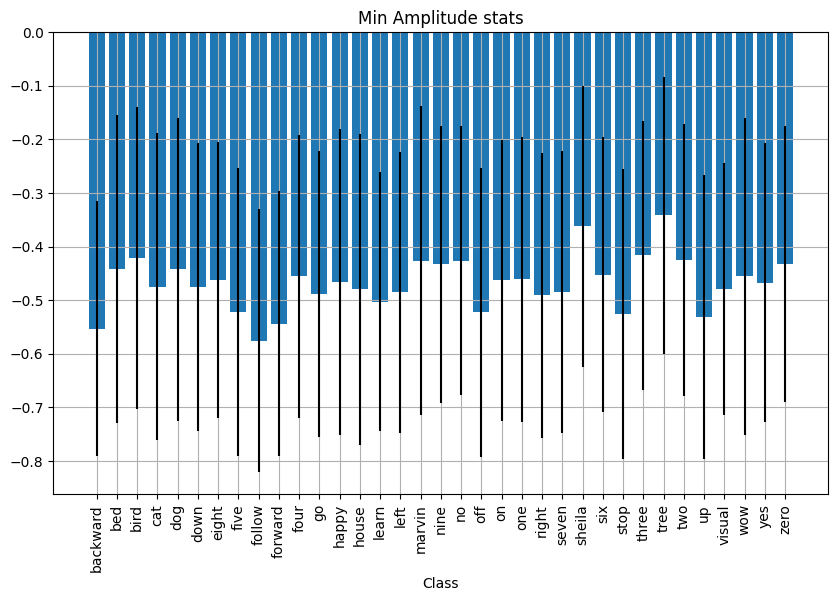

In [20]:
plt.figure(figsize=(10, 6))
plt.bar(amplitude.index, amplitude['mean amplitude']['mean'], yerr=amplitude['mean amplitude']['std'])
plt.title('Mean Amplitude stats')
plt.xlabel('Class')
plt.ylabel('Amplitude')

plt.xticks(rotation=90)
plt.grid()

plt.figure(figsize=(10, 6))
plt.bar(amplitude.index, amplitude['max amplitude']['mean'], yerr=amplitude['max amplitude']['std'])
plt.title('Max Amplitude stats')
plt.xlabel('Class')

plt.xticks(rotation=90)
plt.grid()

plt.figure(figsize=(10, 6))
plt.bar(amplitude.index, amplitude['min amplitude']['mean'], yerr=amplitude['min amplitude']['std'])
plt.title('Min Amplitude stats')
plt.xlabel('Class')

plt.xticks(rotation=90)
plt.grid()
plt.show()

### (b) Plotting Waveform, Spectrogram and Mel Spectrogram

In [21]:
# Randomly selecting 3 audio files from 3 randomly selected classes out of 35 classes
audio_files = []

classes = np.array(os.listdir(data_path))
classes = np.delete(classes, np.where(classes == '_background_noise_'))

for class_ in random.choices(classes, k=3):
    class_path = os.path.join(data_path, class_)
    for file in np.random.choice(os.listdir(class_path), 3, replace=False):
        if file.endswith('.wav'):
            file_path = os.path.join(class_path, file)

            y, sr = get_amplitude(file_path)
            audio_files.append({
                'file': file,
                'class': class_,
                'y': y,
                'sr': sr
            })

df_audio = pd.DataFrame(audio_files)
df_audio = df_audio.sort_values(by='class')
df_audio.reset_index(drop=True, inplace=True)
df_audio

,file,class,y,sr
0,e04d7130_nohash_0.wav,bird,"[6.1035156e-05, 0.00015258789, 0.00012207031, ...",16000
1,234ab0fb_nohash_0.wav,bird,"[-0.00015258789, -0.0023498535, -0.0031738281,...",16000
2,ec32860c_nohash_1.wav,bird,"[-0.043792725, -0.04953003, -0.052856445, -0.0...",16000
3,ab9b93e4_nohash_1.wav,go,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",16000
4,617de221_nohash_0.wav,go,"[-0.0020446777, -0.003112793, -0.00390625, -0....",16000
5,8fe67225_nohash_1.wav,go,"[-0.0002746582, -0.00048828125, -0.00030517578...",16000
6,0ff728b5_nohash_0.wav,happy,"[0.0, 3.0517578e-05, -3.0517578e-05, -6.103515...",16000
7,18f8afd5_nohash_0.wav,happy,"[-0.00015258789, -0.0011291504, -0.0024719238,...",16000
8,283d7a53_nohash_0.wav,happy,"[-0.001159668, 0.0005187988, -0.0004272461, 0....",16000


In [22]:
# playing audio files
for i in range(len(df_audio)):
    print(f'Class: {df_audio.loc[i, "class"]}, File: {df_audio.loc[i, "file"]}')
    ipd.display(ipd.Audio(df_audio.loc[i, 'y'], rate=df_audio.loc[i, 'sr']))

Class: bird, File: e04d7130_nohash_0.wav


Class: bird, File: 234ab0fb_nohash_0.wav


Class: bird, File: ec32860c_nohash_1.wav


Class: go, File: ab9b93e4_nohash_1.wav


Class: go, File: 617de221_nohash_0.wav


Class: go, File: 8fe67225_nohash_1.wav


Class: happy, File: 0ff728b5_nohash_0.wav


Class: happy, File: 18f8afd5_nohash_0.wav


Class: happy, File: 283d7a53_nohash_0.wav


Waveform is used to visualize the amplitude of the data. It is a plot of amplitude vs time. 

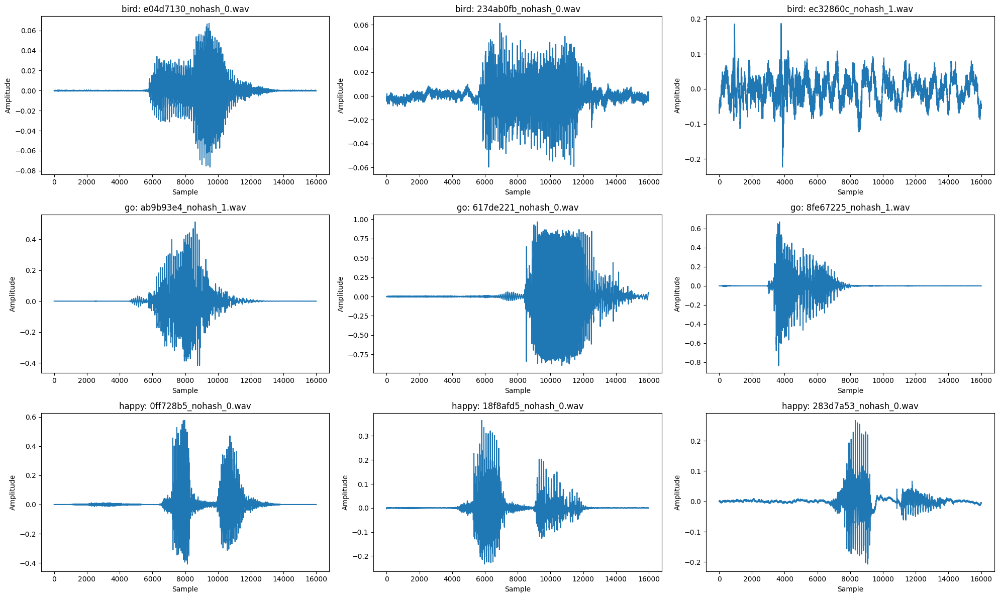

In [23]:
# waveform
plt.figure(figsize=(20, 12))
for i in range(len(df_audio)):
    plt.subplot(3, 3, i+1)
    plt.plot(df_audio['y'][i])
    plt.title(f'{df_audio["class"][i]}: {df_audio["file"][i]}')
    plt.xlabel('Sample')
    plt.ylabel('Amplitude')

plt.tight_layout()
plt.show()

Spectrogram is used to visualize the frequency content of the data. It is a plot of frequency vs time. The color intensity represents the amplitude of the frequency at that time.

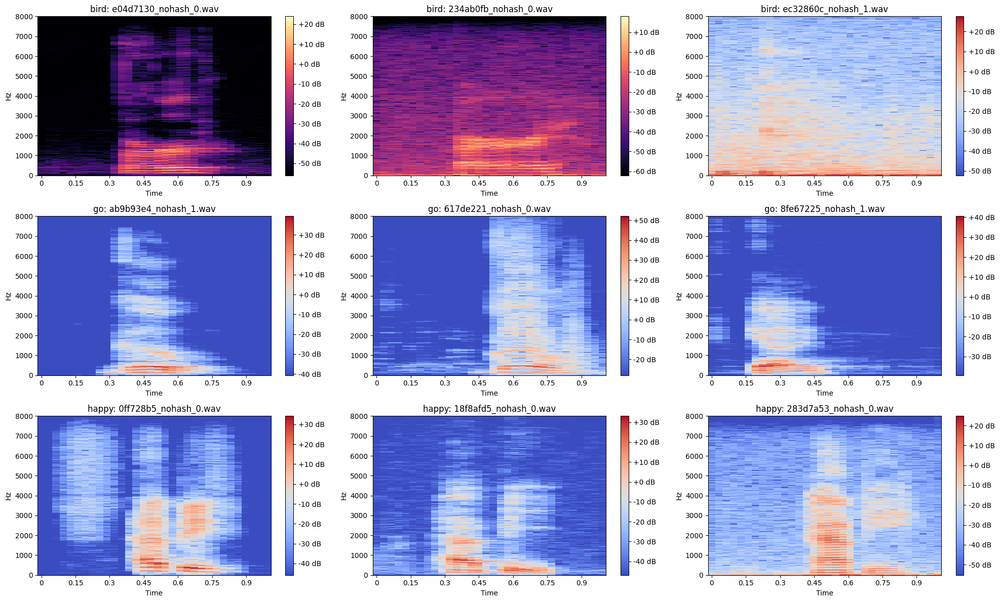

In [24]:
# spectrogram
plt.figure(figsize=(20, 12))
for i in range(len(df_audio)):
    plt.subplot(3, 3, i+1)
    stft = librosa.stft(df_audio['y'][i])
    spectrogram = librosa.amplitude_to_db(np.abs(stft))

    librosa.display.specshow(spectrogram, sr=df_audio['sr'][i], x_axis='time', y_axis='hz')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f'{df_audio["class"][i]}: {df_audio["file"][i]}')


plt.tight_layout()
plt.show()

Mel Spectrogram is used to visualize the frequency content of the data. It is a plot of mel frequency vs time. The color intensity represents the amplitude of the mel frequency at that time. \
Mel frequency is a scale that is more similar to human perception of sound. It is calculated using the formula: \
$$
m = 2595 \times \log_{10}(1 + \frac{f}{700})
$$

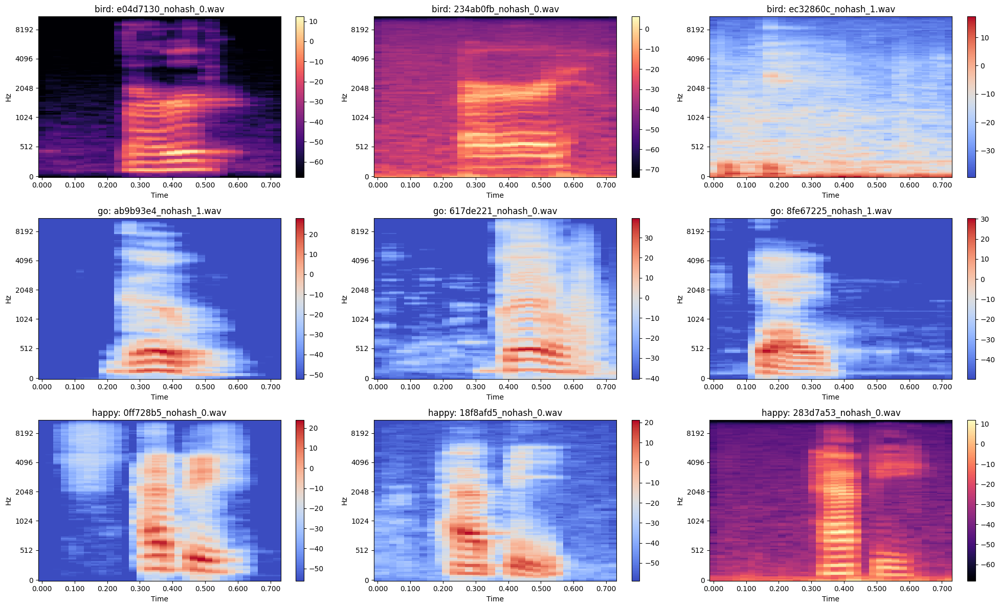

In [25]:
# mel spectrogram
plt.figure(figsize=(20, 12))
for i in range(len(df_audio)):
    plt.subplot(3, 3, i+1)
    mel_spectrogram = librosa.feature.melspectrogram(y=df_audio['y'][i], sr=df_audio['sr'][i])

    librosa.display.specshow(librosa.power_to_db(mel_spectrogram), y_axis='mel', x_axis='time')
    plt.colorbar()
    plt.title(f'{df_audio["class"][i]}: {df_audio["file"][i]}')

plt.tight_layout()
plt.show()

### (c) Finding class imbalances and handling them using under sampling

In [27]:
# finding count of each class and storing them in a dataframe
class_count = pd.DataFrame(df_stats['class'].value_counts()).reset_index()
class_count.columns = ['class', 'count']
class_count.sort_values(by='count', inplace=True)
class_count.reset_index(drop=True, inplace=True)
class_count

,class,count
0,forward,1557
1,learn,1575
2,follow,1579
3,visual,1592
4,backward,1664
5,tree,1759
6,bed,2014
7,sheila,2022
8,cat,2031
9,happy,2054


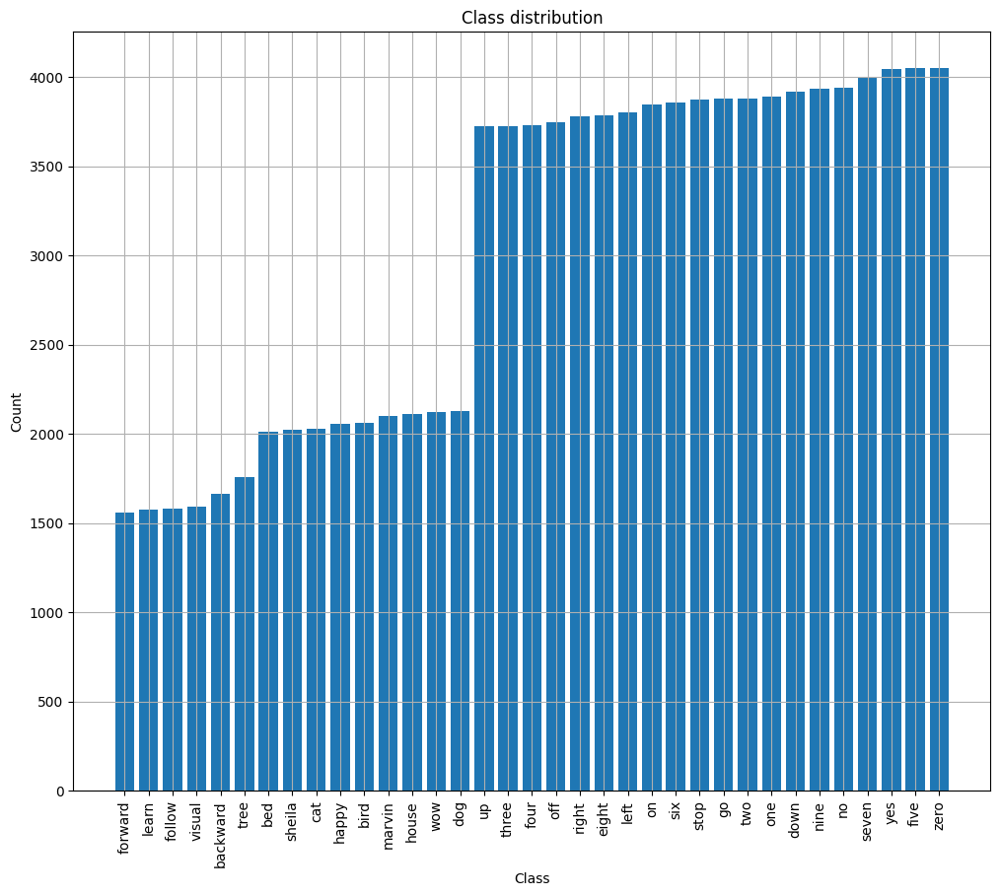

In [28]:
plt.figure(figsize=(12, 10))
plt.bar(class_count['class'], class_count['count'])
plt.title('Class distribution')
plt.xlabel('Class')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.grid()
plt.show()

The countplot suggests that the data is imbalanced. We can handle this by under sampling the data. We can randomly sample the data from the classes with more samples to match the number of samples in the class with the least number of samples.

#### Under-sampling is a technique used to balance the class distribution of a dataset by reducing the number of samples in the over-represented class.

In [31]:
# undersampling
min_count = class_count['count'].min()

for class_ in class_count['class']:
    class_path = os.path.join(data_path, class_)
    for file in np.random.choice(os.listdir(class_path), len(os.listdir(class_path)) - min_count, replace=False):
        if file.endswith('.wav'):
            file_path = os.path.join(class_path, file)
            os.remove(file_path)

In [40]:
stats_new = []
# creating a new dataframe after undersampling
for class_ in os.listdir(data_path):
    if class_ == '_background_noise_':
        continue
    class_path = os.path.join(data_path, class_)
    for file in os.listdir(class_path):
        if file.endswith('.wav'):
            file_path = os.path.join(class_path, file)
            y, sr = get_amplitude(file_path)

            stats = {
                'file': file,
                'class': class_,
                'y': y,
                'sr': sr,
            }

            stats_new.append(stats)

In [34]:
df_stats = pd.DataFrame(stats_new)
df_stats.sort_values(by='class', inplace=True)
df_stats.reset_index(drop=True, inplace=True)
df_stats

,file,class,y,sr
0,0165e0e8_nohash_0.wav,backward,"[-0.06576538, -0.07092285, -0.07531738, -0.079...",16000
1,b29f8b23_nohash_1.wav,backward,"[-0.00024414062, -0.0070495605, -0.01687622, -...",16000
2,b29f8b23_nohash_0.wav,backward,"[-0.00088500977, -0.0018005371, -0.0016479492,...",16000
3,b0f5b16d_nohash_4.wav,backward,"[0.0, 0.0, -3.0517578e-05, -6.1035156e-05, -6....",16000
4,b0f5b16d_nohash_3.wav,backward,"[-3.0517578e-05, -3.0517578e-05, 6.1035156e-05...",16000
...,...,...,...,...
54490,51f7a034_nohash_3.wav,zero,"[0.00021362305, -6.1035156e-05, -0.00021362305...",16000
54491,51f7a034_nohash_2.wav,zero,"[3.0517578e-05, 6.1035156e-05, 0.00012207031, ...",16000
54492,5184ed3e_nohash_0.wav,zero,"[0.0012512207, 0.0038757324, 0.0058898926, 0.0...",16000
54493,563aa4e6_nohash_2.wav,zero,"[0.00024414062, 0.00024414062, 0.00021362305, ...",16000


In [35]:
# finding count of each class and storing
class_count = pd.DataFrame(df_stats['class'].value_counts()).reset_index()
class_count.columns = ['class', 'count']
class_count.sort_values(by='count', inplace=True)
class_count.reset_index(drop=True, inplace=True)
class_count

,class,count
0,backward,1557
1,follow,1557
2,bird,1557
3,cat,1557
4,dog,1557
5,down,1557
6,eight,1557
7,bed,1557
8,five,1557
9,marvin,1557


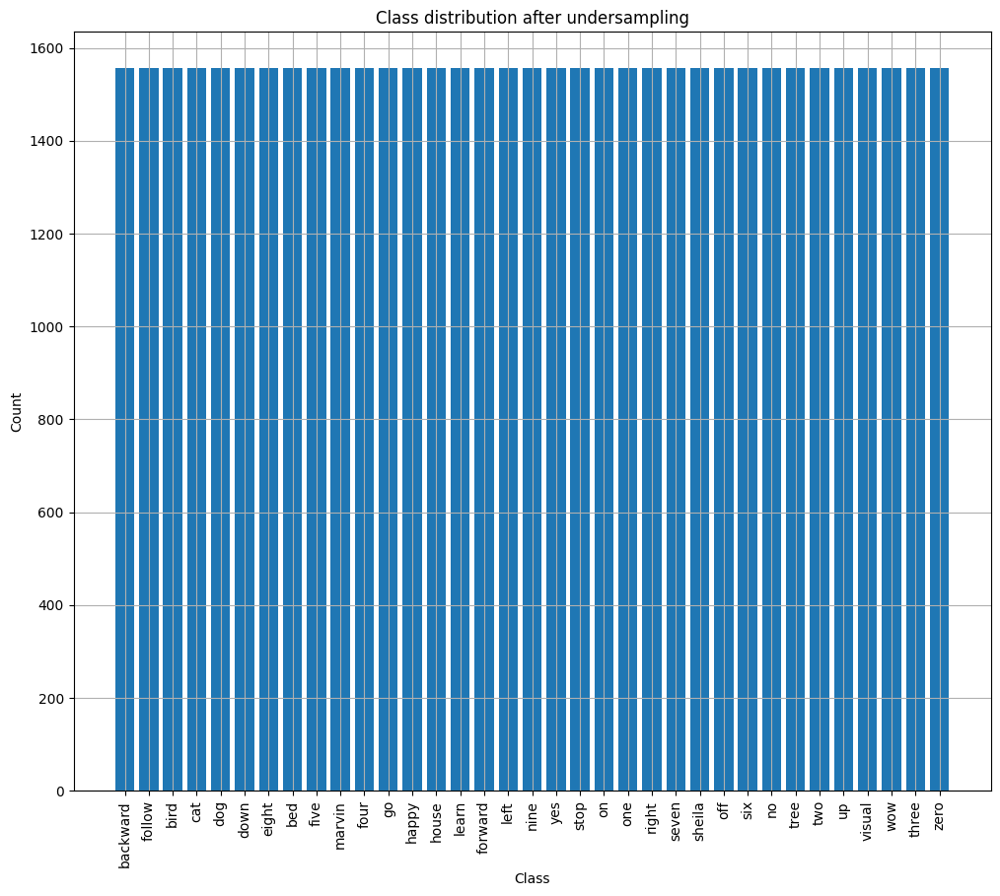

In [36]:
plt.figure(figsize=(12, 10))
plt.bar(class_count['class'], class_count['count'])
plt.title('Class distribution after undersampling')
plt.xlabel('Class')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.grid()
plt.show()

Each class has 1557 samples after under sampling.

### (d) Cleaning the data by removing silence and low noise from the audio files

In [81]:
# # removing files starting with clean
# for class_ in os.listdir(data_path):
#     if class_ == '_background_noise_':
#         continue
#     class_path = os.path.join(data_path, class_)
#     for file in os.listdir(class_path):
#         if file.startswith('clean'):
#             os.remove(os.path.join(class_path, file))

In [37]:
def detect_silent_segments(audio, sr, threshold=0.05, min_silence_len=0.2):

    min_silence_samples = int(min_silence_len * sr)

    silent_samples = np.where(np.abs(audio) < threshold)[0]

    silence_segments = []
    start = None
    for i in range(1, len(silent_samples)):
        if silent_samples[i] != silent_samples[i-1] + 1:
            if start is not None and i - start >= min_silence_samples:
                silence_segments.append((silent_samples[start] / sr, silent_samples[i-1] / sr))
            start = None  
        else:
            if start is None:
                start = i

    if start is not None and len(silent_samples) - start >= min_silence_samples:
        silence_segments.append((silent_samples[start] / sr, silent_samples[-1] / sr))
    
    return silence_segments

In [38]:
def remove_silent_segments(audio, sr, silence_segments):

    cleaned_audio = []
    prev_end = 0
    for start, end in silence_segments:
        cleaned_audio.append(audio[int(prev_end * sr):int(start * sr)])
        prev_end = end
    cleaned_audio.append(audio[int(prev_end * sr):])
    
    return np.concatenate(cleaned_audio)

In [41]:
# testing on a single audio file
file_path = 'data/yes/0a2b400e_nohash_0.wav'
y, sr = get_amplitude(file_path)

silence_segments = detect_silent_segments(y, sr)
cleaned_audio = remove_silent_segments(y, sr, silence_segments)

ipd.display(ipd.Audio(y, rate=sr))

Writing cleaned audio files into the dirrectory.

In [39]:
for class_ in os.listdir(data_path):
    if class_ == '_background_noise_':
        continue
    class_path = os.path.join(data_path, class_)
    for file in os.listdir(class_path):
        if file.endswith('.wav'):
            file_path = os.path.join(class_path, file)
            
            y, sr = get_amplitude(file_path)

            silent_segments = detect_silent_segments(y, sr)
            clean_audio = remove_silent_segments(y, sr, silent_segments)

            if clean_audio.shape[0] < sr:
                clean_audio = np.pad(clean_audio, (0, sr - clean_audio.shape[0]))
            elif clean_audio.shape[0] > sr:
                clean_audio = clean_audio[:sr]

            clean_file_path = os.path.join(class_path, f'clean_{file}')
            soundfile.write(clean_file_path, clean_audio, sr)

In [6]:
classes = np.array(os.listdir(data_path))

In [42]:
cleaned_audio = []

for class_ in random.choices(classes, k=3):
    class_path = os.path.join(data_path, class_)
    files = os.listdir(class_path)
    files = [file for file in files if file.startswith('clean_')]
    for file in np.random.choice(files, 3, replace=False):
        file_path = os.path.join(class_path, file)

        y, sr = get_amplitude(file_path)
        duration = librosa.get_duration(y=y, sr=sr)
        cleaned_audio.append({
            'file': file,
            'class': class_,
            'y': y,
            'sr': sr,
            'duration' : duration
        })

df_cleaned_audio = pd.DataFrame(cleaned_audio)
df_cleaned_audio = df_cleaned_audio.sort_values(by='class')
df_cleaned_audio.reset_index(drop=True, inplace=True)
df_cleaned_audio

,file,class,y,sr,duration
0,clean_3d86b69a_nohash_3.wav,no,"[0.036895752, 0.04159546, 0.04626465, 0.050750...",16000,1.0
1,clean_0c2d2ffa_nohash_0.wav,no,"[0.0005493164, 0.039215088, 0.052612305, 0.063...",16000,1.0
2,clean_81332c92_nohash_3.wav,no,"[0.00018310547, -0.040618896, -0.05014038, -0....",16000,1.0
3,clean_5b09db89_nohash_0.wav,no,"[-0.0013427734, -0.0034484863, -0.005279541, -...",16000,1.0
4,clean_e32ff49d_nohash_2.wav,no,"[-0.00018310547, -0.0010681152, -0.001373291, ...",16000,1.0
5,clean_bfd26d6b_nohash_1.wav,no,"[3.0517578e-05, -0.00018310547, -3.0517578e-05...",16000,1.0
6,clean_24a3e589_nohash_1.wav,zero,"[-9.1552734e-05, -9.1552734e-05, -6.1035156e-0...",16000,1.0
7,clean_b97c9f77_nohash_3.wav,zero,"[-0.00036621094, -0.04638672, -0.05029297, -0....",16000,1.0
8,clean_71d0ded4_nohash_3.wav,zero,"[-0.00012207031, 0.048309326, 0.058013916, 0.0...",16000,1.0


In [43]:
for i in range(len(df_cleaned_audio)):
    print(f'Class: {df_cleaned_audio.loc[i, "class"]}, File: {df_cleaned_audio.loc[i, "file"]}')
    ipd.display(ipd.Audio(df_cleaned_audio.loc[i, 'y'], rate=df_cleaned_audio.loc[i, 'sr']))

Class: no, File: clean_3d86b69a_nohash_3.wav


Class: no, File: clean_0c2d2ffa_nohash_0.wav


Class: no, File: clean_81332c92_nohash_3.wav


Class: no, File: clean_5b09db89_nohash_0.wav


Class: no, File: clean_e32ff49d_nohash_2.wav


Class: no, File: clean_bfd26d6b_nohash_1.wav


Class: zero, File: clean_24a3e589_nohash_1.wav


Class: zero, File: clean_b97c9f77_nohash_3.wav


Class: zero, File: clean_71d0ded4_nohash_3.wav


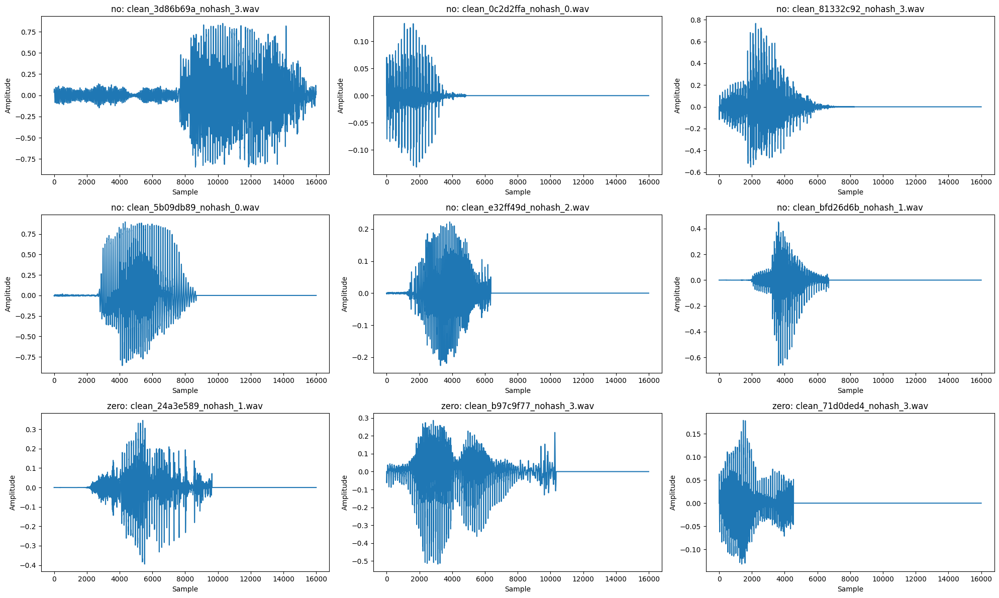

In [44]:
plt.figure(figsize=(20, 12))
for i in range(len(df_cleaned_audio)):
    plt.subplot(3, 3, i+1)
    plt.plot(df_cleaned_audio['y'][i])
    plt.title(f'{df_cleaned_audio["class"][i]}: {df_cleaned_audio["file"][i]}')
    plt.xlabel('Sample')
    plt.ylabel('Amplitude')

plt.tight_layout()
plt.show()

From the above plots we can see that silence has been removed from between the words.

In [45]:
# removing low noise from the cleaned audio
def calc_snr(audio, noise_threshold=0.02):
    signal_power = np.mean(audio ** 2)
    noise_power = np.mean(audio[np.abs(audio) < noise_threshold] ** 2)

    if noise_power == 0:
        return float('inf')
    
    snr = 10 * np.log10(signal_power / noise_power)

    return snr

In [94]:
# testing on a single audio file
file_path = 'data/yes/clean_0a2b400e_nohash_0.wav'
y, sr = get_amplitude(file_path)
snr = calc_snr(y)
print(f'SNR: {snr}')
if snr < 10:
    print("file would be removed")
else:
    print("file would be kept")

SNR: 25.70021390914917
file would be kept


Removing files which have signal to noise ratio less than 10.

In [46]:
clean_audio_df = []

for class_ in os.listdir(data_path):
    if class_ == '_background_noise_':
        continue
    class_path = os.path.join(data_path, class_)
    counter = 0
    for file in os.listdir(class_path):
        if file.startswith('clean_') and file.endswith('.wav'):
            file_path = os.path.join(class_path, file)
            y, sr = get_amplitude(file_path)
            snr = calc_snr(y)
            # print(f'Class: {class_}, File: {file}, SNR: {snr}')
            if snr < 10:
                os.remove(file_path)
            else:
                counter += 1
                clean_audio_df.append({
                    'file': file,
                    'class': class_,
                    'y': y,
                })
    print(f'Class: {class_}, Files kept: {counter}')

df_clean_audio = pd.DataFrame(clean_audio_df)
df_clean_audio.sort_values(by='class', inplace=True)
df_clean_audio.reset_index(drop=True, inplace=True)
df_clean_audio
# if clean_audio_df:
#     clean_audio_df = pd.DataFrame(clean_audio_df)

#     print(clean_audio_df.head())

#     if 'class' in clean_audio_df.columns:
#         clean_audio_df.sort_values(by='class', inplace=True)
#         clean_audio_df.reset_index(drop=True, inplace=True)
#     else:
#         print("The 'class' column is missing from the DataFrame.")
# else:
#     print("No clean audio files found.")

# clean_audio_df

Class: backward, Files kept: 1524
Class: bed, Files kept: 1487
Class: bird, Files kept: 1468
Class: cat, Files kept: 1475


C:\Users\Ritika\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\core\fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\Ritika\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\numpy\core\_methods.py:129: RuntimeWarning: invalid value encountered in divide
  ret = ret.dtype.type(ret / rcount)


Class: dog, Files kept: 1451
Class: down, Files kept: 1475
Class: eight, Files kept: 1514
Class: five, Files kept: 1510
Class: follow, Files kept: 1509
Class: forward, Files kept: 1510
Class: four, Files kept: 1486
Class: go, Files kept: 1506
Class: happy, Files kept: 1473
Class: house, Files kept: 1461
Class: learn, Files kept: 1522
Class: left, Files kept: 1511
Class: marvin, Files kept: 1397
Class: nine, Files kept: 1453
Class: no, Files kept: 1490
Class: off, Files kept: 1516
Class: on, Files kept: 1494
Class: one, Files kept: 1489
Class: right, Files kept: 1489
Class: seven, Files kept: 1490
Class: sheila, Files kept: 1354
Class: six, Files kept: 1464
Class: stop, Files kept: 1515
Class: three, Files kept: 1468
Class: tree, Files kept: 1397
Class: two, Files kept: 1494
Class: up, Files kept: 1536
Class: visual, Files kept: 1488
Class: wow, Files kept: 1429
Class: yes, Files kept: 1475
Class: zero, Files kept: 1447


,file,class,y
0,clean_0165e0e8_nohash_0.wav,backward,"[-0.06576538, -0.07092285, -0.07531738, -0.079..."
1,clean_b2ae3928_nohash_0.wav,backward,"[6.1035156e-05, 0.027130127, 0.050567627, 0.03..."
2,clean_b29f8b23_nohash_3.wav,backward,"[0.0024719238, 0.0012512207, -0.0010375977, 0...."
3,clean_b29f8b23_nohash_2.wav,backward,"[-0.0002746582, -0.00030517578, -6.1035156e-05..."
4,clean_b29f8b23_nohash_1.wav,backward,"[-0.00024414062, -0.0070495605, -0.01687622, -..."
...,...,...,...
51762,clean_520e8c0e_nohash_0.wav,zero,"[0.0, 0.028961182, 0.050689697, 0.040008545, 0..."
51763,clean_51f7a034_nohash_3.wav,zero,"[0.00021362305, -6.1035156e-05, -0.00021362305..."
51764,clean_51f7a034_nohash_2.wav,zero,"[3.0517578e-05, 0.04373169, 0.09451294, 0.1026..."
51765,clean_5170b77f_nohash_4.wav,zero,"[0.0007324219, 0.0007324219, 0.0009460449, 0.0..."


In [47]:
# # checking to see if duplicate files are present in a class
# for class_ in os.listdir(data_path):
#     if class_ == '_background_noise_':
#         continue
#     class_path = os.path.join(data_path, class_)
#     files = os.listdir(class_path)
#     files = [file for file in files if file.startswith('clean_')]
#     if len(files) != len(set(files)):
#         print(f'Duplicates found in class: {class_}')

In [51]:
# counting total number of files
total_files = len(df_clean_audio)
print(f'Total number of files: {total_files}')

Total number of files: 51767


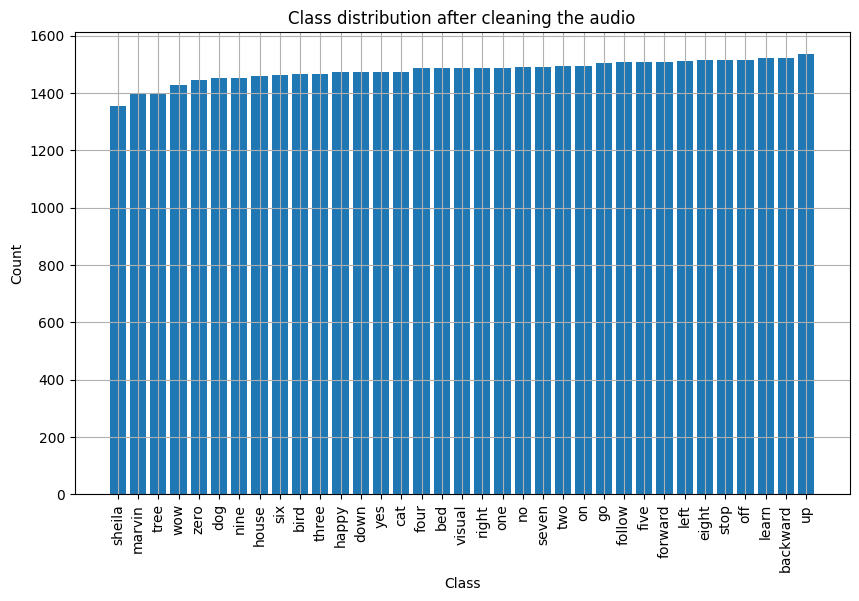

In [52]:
counts = pd.DataFrame(df_clean_audio['class'].value_counts()).reset_index()
counts.columns = ['class', 'count']
counts.sort_values(by='count', inplace=True)
counts.reset_index(drop=True, inplace=True)

plt.figure(figsize=(10, 6))
plt.bar(counts['class'], counts['count'])
plt.title('Class distribution after cleaning the audio')
plt.xlabel('Class')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.grid()
plt.show()

We now have a balanced dataset where each class has clean audio files.

## (2) Feature Extraction

rms - root mean square of the audio signal \
rms is a measure of the power of the audio signal. It is calculated as the square root of the mean of the square of the audio signal.


In [53]:
def rms(y=None, S=None, frame_length=2048, hop_length=512, center=True, pad_mode="constant", dtype=np.float32):

    # If `y` (audio samples) is provided
    if y is not None:
        if center:
            # Padding the signal to center the frames
            padding = [(0, 0) for _ in range(y.ndim)]  # Padding setup for all dimensions
            padding[-1] = (int(frame_length // 2), int(frame_length // 2))  # Last axis is the time axis
            y = np.pad(y, padding, mode=pad_mode)

        # Frame the audio signal
        x = frame(y, frame_length=frame_length, hop_length=hop_length)

        # Calculate the power (mean squared value)
        power = np.mean(abs2(x, dtype=dtype), axis=-2, keepdims=True)

    # If `S` (spectrogram) is provided
    elif S is not None:
        # Validate frame length for spectrogram input
        if S.shape[-2] != frame_length // 2 + 1:
            raise ValueError(
                f"S.shape[-2] is {S.shape[-2]}, but frame_length should be {S.shape[-2] * 2 - 2} or "
                f"{S.shape[-2] * 2 - 1}, found {frame_length}"
            )

        # Compute power from spectrogram magnitude
        x = abs2(S, dtype=dtype)

        # Adjust for DC (0 Hz) and Nyquist (sr/2) components
        x[..., 0, :] *= 0.5  # Adjust DC component
        if frame_length % 2 == 0:
            x[..., -1, :] *= 0.5  # Adjust Nyquist component for even frame lengths

        # Calculate the power by summing across frequency bins
        power = 2 * np.sum(x, axis=-2, keepdims=True) / frame_length**2

    else:
        raise ValueError("Either `y` or `S` must be provided as input.")

    # Compute the RMS value (square root of power)
    rms_result = np.sqrt(power)
    return rms_result

zcr - zero crossing rate of the audio signal \
zcr is a measure of the number of times the audio signal crosses the zero axis. It is calculated as the number of times the audio signal changes sign divided by the total number of samples.

In [54]:
def zero_crossings(y, threshold=1e-10, ref_magnitude=None, pad=True, zero_pos=True, axis=-1):

    # Apply ref_magnitude scaling to threshold if needed
    if callable(ref_magnitude):
        threshold = threshold * ref_magnitude(np.abs(y))
    elif ref_magnitude is not None:
        threshold = threshold * ref_magnitude

    # Swap the specified axis to the last axis for easier processing
    y_swapped = np.swapaxes(y, axis, -1)

    # Initialize a boolean array for zero-crossings
    z = np.empty_like(y_swapped, dtype=bool)

    # Compute the sign difference between consecutive elements to detect zero-crossings
    z[..., :-1] = np.sign(y_swapped[..., :-1]) != np.sign(y_swapped[..., 1:])

    # Handle the case of zero_pos, where 0 is treated as positive
    if zero_pos:
        z[..., :-1] |= (y_swapped[..., :-1] == 0)

    # Pad the first element with `True` if `pad=True`
    z[..., 0] = pad

    # Swap the axes back to the original order
    return np.swapaxes(z, -1, axis)

def zero_crossing_rate(y: np.ndarray, frame_length: int = 2048, hop_length: int = 512, center: bool = True, threshold: float = 0.0, ref_magnitude: float = 1.0, zero_pos: bool = True, axis: int = -2):
    if center:
        padding = [(0, 0) for _ in range(y.ndim)]
        padding[-1] = (int(frame_length // 2), int(frame_length // 2))
        y = np.pad(y, padding, mode="edge")

    # Frame the audio signal
    y_framed = frame(y, frame_length=frame_length, hop_length=hop_length)

    # Compute zero crossings
    crossings = zero_crossings(y_framed, threshold=threshold, ref_magnitude=ref_magnitude, zero_pos=zero_pos, axis=axis)

    # Calculate zero-crossing rate
    zcr = np.mean(crossings, axis=axis, keepdims=True)

    return zcr

formants - formants of the audio signal \
Formants are the resonant frequencies of the vocal tract. They are calculated using linear predictive coding (LPC).\
LPC is a method used to represent the spectral envelope of the audio signal. It is calculated by finding the coefficients of the filter that best fits the audio signal.

In [55]:
def lpc(signal, order):
    # Autocorrelation method for LPC
    autocorr = np.correlate(signal, signal, mode='full')
    autocorr = autocorr[len(autocorr)//2:]
    
    R = autocorr[:order + 1]
    a = np.zeros(order)
    E = R[0]
    
    for i in range(order):
        # Reflection coefficient
        if E == 0:
            break
        k = - (R[i+1] + np.dot(a[:i], R[i:0:-1])) / E
        a[i] = k
        
        # Update LPC coefficients
        if i > 0:
            a[:i] += k * a[i-1::-1]
        
        # Update error
        E *= (1 - k**2)
    
    return np.hstack([[1], -a])

def get_formants(audio, sr):
    # Step 1: Apply pre-emphasis to the audio signal to enhance higher frequencies
    pre_emphasis = 0.97
    emphasized_audio = np.append(audio[0], audio[1:] - pre_emphasis * audio[:-1])
    
    # Step 2: Frame the signal (breaking into short segments) and apply LPC
    frame_size = int(0.025 * sr)  # 25ms window size
    frame_stride = int(0.01 * sr) # 10ms stride
    frames = []
    
    # Sliding window to break signal into frames
    for i in range(0, len(emphasized_audio) - frame_size, frame_stride):
        frames.append(emphasized_audio[i:i + frame_size])
    
    # Step 3: LPC analysis
    formants = []
    for frame in frames:
        # Apply Hamming window to each frame
        windowed_frame = frame * np.hamming(len(frame))
        
        # Perform LPC analysis (using order 2 + sr // 1000, a common heuristic for LPC order)
        lpc_coeffs = lpc(windowed_frame, 2 + sr // 1000)
        
        # Step 4: Find roots of the LPC polynomial and keep only the roots that are within human speech range
        roots = np.roots(lpc_coeffs)
        roots = [r for r in roots if np.imag(r) >= 0]
        
        # Convert roots into formant frequencies
        formant_freqs = np.angle(roots) * (sr / (2 * np.pi))
        
        # Keep the first three formants (F1, F2, F3)
        formant_freqs = sorted(formant_freqs)
        if len(formant_freqs) >= 3:
            formants.append(formant_freqs[:3])
    
    # Average formants over all frames
    formants = np.mean(formants, axis=0)
    
    return formants

The above codes have been taken from the source codes of the respective libraries: https://github.com/librosa/librosa/blob/main/librosa/feature/spectral.py 

We are going to extract the followinf features: MFCC, RMS, ZCR, Spectral Centroid, Spectral Bandwidth, Spectral Contrast, Spectral Rolloff, Chroma, Mel Spectrogram, Spectral Flatness, Tempo, Pitch, Mel Spectogram, Chroma_cqt and Formants.

In [59]:
feature_names = []
class_labels = []
audio_files = []

for class_ in os.listdir(data_path):
    if class_ == '_background_noise_':
        continue
    class_path = os.path.join(data_path, class_)
    for file in os.listdir(class_path):
        if file.endswith('.wav') and file.startswith('clean_'):
            file_path = os.path.join(class_path, file)
            audio, sr = get_amplitude(file_path)

            # MFCC
            mfcc = librosa.feature.mfcc(y=audio, sr=sr, n_mfcc=13)
            mfcc_mean = np.mean(mfcc, axis=1)

            mfcc_delta = librosa.feature.delta(mfcc)
            mfcc_delta_mean = np.mean(mfcc_delta, axis=1)

            mfcc_delta2 = librosa.feature.delta(mfcc, order=2)
            mfcc_delta2_mean = np.mean(mfcc_delta2, axis=1)

            # Chroma
            chroma = librosa.feature.chroma_stft(y=audio, sr=sr)
            chroma_mean = np.mean(chroma, axis=1)

            # Spectral
            spectral_centroid = librosa.feature.spectral_centroid(y=audio, sr=sr)
            spectral_centroid_mean = np.mean(spectral_centroid)

            spectral_bandwidth = librosa.feature.spectral_bandwidth(y=audio, sr=sr)
            spectral_bandwidth_mean = np.mean(spectral_bandwidth)

            spectral_contrast = librosa.feature.spectral_contrast(y=audio, sr=sr)
            spectral_contrast_mean = np.mean(spectral_contrast, axis=1)

            spectral_flatness = librosa.feature.spectral_flatness(y=audio)
            spectral_flatness_mean = np.mean(spectral_flatness)

            spectral_roloff = librosa.feature.spectral_rolloff(y=audio, sr=sr)
            spectral_roloff_mean = np.mean(spectral_roloff)

            # RMS
            rms_value = rms(y=audio)
            rms_mean = np.mean(rms_value)

            # Zero crossing rate
            zcr = zero_crossing_rate(y=audio)
            zcr_mean = np.mean(zcr)

            # Tempo
            # onset_env = librosa.onset.onset_strength(y=audio, sr=sr)
            tempo, _ = librosa.beat.beat_track(y=audio, sr=sr)

            # Pitch
            pitches, magnitudes = librosa.piptrack(y=audio, sr=sr)
            pitch_mean = np.mean(pitches)

            # Mel spectrogram
            mel_spectrogram = librosa.feature.melspectrogram(y=audio, sr=sr)
            mel_spectrogram_mean = np.mean(mel_spectrogram)

            # Chroma cqt
            chroma_cqt = librosa.feature.chroma_cqt(y=audio, sr=sr)
            chroma_cqt_mean = np.mean(chroma_cqt, axis=1)

            # Formant
            f1, f2, f3 = get_formants(audio, sr)

            features = {'mfcc_1' : mfcc_mean[0], 'mfcc_2' : mfcc_mean[1], 'mfcc_3' : mfcc_mean[2], 'mfcc_4' : mfcc_mean[3],
                        'mfcc_5' : mfcc_mean[4], 'mfcc_6' : mfcc_mean[5], 'mfcc_7' : mfcc_mean[6], 'mfcc_8' : mfcc_mean[7],
                        'mfcc_9' : mfcc_mean[8], 'mfcc_10' : mfcc_mean[9], 'mfcc_11' : mfcc_mean[10], 'mfcc_12' : mfcc_mean[11],
                        'mfcc_13' : mfcc_mean[12], 

                        'mfcc_delta_1' : mfcc_delta_mean[0], 'mfcc_delta_2' : mfcc_delta_mean[1], 'mfcc_delta_3' : mfcc_delta_mean[2],
                        'mfcc_delta_4' : mfcc_delta_mean[3], 'mfcc_delta_5' : mfcc_delta_mean[4], 'mfcc_delta_6' : mfcc_delta_mean[5],
                        'mfcc_delta_7' : mfcc_delta_mean[6], 'mfcc_delta_8' : mfcc_delta_mean[7], 'mfcc_delta_9' : mfcc_delta_mean[8],
                        'mfcc_delta_10' : mfcc_delta_mean[9], 'mfcc_delta_11' : mfcc_delta_mean[10], 'mfcc_delta_12' : mfcc_delta_mean[11],
                        'mfcc_delta_13' : mfcc_delta_mean[12],

                        'mfcc_delta2_1' : mfcc_delta2_mean[0], 'mfcc_delta2_2' : mfcc_delta2_mean[1], 'mfcc_delta2_3' : mfcc_delta2_mean[2],
                        'mfcc_delta2_4' : mfcc_delta2_mean[3], 'mfcc_delta2_5' : mfcc_delta2_mean[4], 'mfcc_delta2_6' : mfcc_delta2_mean[5],
                        'mfcc_delta2_7' : mfcc_delta2_mean[6], 'mfcc_delta2_8' : mfcc_delta2_mean[7], 'mfcc_delta2_9' : mfcc_delta2_mean[8],
                        'mfcc_delta2_10' : mfcc_delta2_mean[9], 'mfcc_delta2_11' : mfcc_delta2_mean[10], 'mfcc_delta2_12' : mfcc_delta2_mean[11],
                        'mfcc_delta2_13' : mfcc_delta2_mean[12],
                        
                        'chroma_1' : chroma_mean[0], 'chroma_2' : chroma_mean[1], 'chroma_3' : chroma_mean[2], 'chroma_4' : chroma_mean[3],
                        'chroma_5' : chroma_mean[4], 'chroma_6' : chroma_mean[5], 'chroma_7' : chroma_mean[6], 'chroma_8' : chroma_mean[7],
                        'chroma_9' : chroma_mean[8], 'chroma_10' : chroma_mean[9], 'chroma_11' : chroma_mean[10], 'chroma_12' : chroma_mean[11],
                        
                        'spectral_centroid' : spectral_centroid_mean, 'spectral_bandwidth' : spectral_bandwidth_mean, 'spectral_roloff' : spectral_roloff_mean,
                        'spectral_contrast_1' : spectral_contrast_mean[0], 'spectral_contrast_2' : spectral_contrast_mean[1], 'spectral_contrast_3' : spectral_contrast_mean[2],
                        'spectral_contrast_4' : spectral_contrast_mean[3], 'spectral_contrast_5' : spectral_contrast_mean[4], 'spectral_contrast_6' : spectral_contrast_mean[5],

                        'spectral_flatness' : spectral_flatness_mean, 'rms' : rms_mean, 'zcr' : zcr_mean, 'tempo' : tempo,
                        'pitch' : pitch_mean, 'mel_spectrogram' : mel_spectrogram_mean, 

                        'chroma_cqt_1' : chroma_cqt_mean[0], 'chroma_cqt_2' : chroma_cqt_mean[1], 'chroma_cqt_3' : chroma_cqt_mean[2], 'chroma_cqt_4' : chroma_cqt_mean[3],
                        'chroma_cqt_5' : chroma_cqt_mean[4], 'chroma_cqt_6' : chroma_cqt_mean[5], 'chroma_cqt_7' : chroma_cqt_mean[6], 'chroma_cqt_8' : chroma_cqt_mean[7],
                        'chroma_cqt_9' : chroma_cqt_mean[8], 'chroma_cqt_10' : chroma_cqt_mean[9], 'chroma_cqt_11' : chroma_cqt_mean[10], 'chroma_cqt_12' : chroma_cqt_mean[11],

                        'f1' : f1, 'f2' : f2, 'f3' : f3
                    }
            
            class_labels.append(class_)
            audio_files.append(file)
            feature_names.append(features)

features_df = pd.DataFrame(feature_names)
features_df['class'] = class_labels
features_df['file'] = audio_files
features_df


,mfcc_1,mfcc_2,mfcc_3,mfcc_4,mfcc_5,mfcc_6,mfcc_7,mfcc_8,mfcc_9,mfcc_10,...,chroma_cqt_8,chroma_cqt_9,chroma_cqt_10,chroma_cqt_11,chroma_cqt_12,f1,f2,f3,class,file
0,-273.752625,139.112671,-2.639945,-13.992020,7.489814,27.705564,-2.080702,8.608751,7.619241,8.314068,...,0.689233,0.531457,0.501974,0.921739,0.761944,380.744927,1160.380124,2091.526513,backward,clean_0165e0e8_nohash_0.wav
1,-401.402832,88.338226,-22.921865,-6.252601,-8.850283,-1.071088,-15.271227,-4.599439,-1.511617,-3.553710,...,0.404423,0.401291,0.393710,0.398683,0.391051,22.923732,428.481894,878.797760,backward,clean_017c4098_nohash_0.wav
2,-462.968506,83.527039,-27.385208,-4.816205,-15.408574,0.764183,-14.083040,-2.860267,2.809035,-5.347560,...,0.448510,0.430138,0.392033,0.430148,0.417420,26.266295,361.601731,673.809719,backward,clean_017c4098_nohash_1.wav
3,-407.912292,87.522057,-26.431669,-3.974614,-5.922104,-4.061956,-15.880999,-5.873802,-0.153263,-5.358046,...,0.588313,0.413832,0.403271,0.327521,0.338784,3.785337,363.591267,847.233996,backward,clean_017c4098_nohash_2.wav
4,-407.722290,79.652122,-25.731075,-8.634889,-12.981051,2.209030,-19.201488,-5.668422,-0.381476,-7.648023,...,0.406228,0.374023,0.411329,0.378122,0.416061,14.737612,270.180014,602.320830,backward,clean_017c4098_nohash_3.wav
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51762,-408.390320,50.964191,8.647757,13.604553,-6.363612,10.950428,-8.548465,3.286843,-8.870875,-3.373331,...,0.555437,0.691443,0.649935,0.527066,0.272044,0.000000,306.043712,708.155797,zero,clean_ff4ed4f3_nohash_2.wav
51763,-350.134827,83.939819,8.200066,4.566678,-15.972693,-5.031384,-18.609982,-6.395767,-10.659006,-14.512265,...,0.492548,0.390530,0.291744,0.294127,0.424121,42.536255,360.740173,832.267431,zero,clean_ffb86d3c_nohash_1.wav
51764,-488.792175,43.622475,14.833714,12.864100,5.101717,10.201158,-6.876867,-8.786090,-4.430212,-2.292406,...,0.577726,0.681388,0.482016,0.241153,0.129245,4.461060,269.511391,604.580195,zero,clean_ffd2ba2f_nohash_1.wav
51765,-463.622467,49.546898,15.482666,20.839153,10.603121,7.938496,-2.162204,-6.451885,-4.534359,0.835135,...,0.434267,0.823979,0.539327,0.390049,0.300337,29.829828,300.739985,797.594284,zero,clean_ffd2ba2f_nohash_2.wav


In [60]:
features_df.sort_values(by='class', inplace=True)
features_df.reset_index(drop=True, inplace=True)

tempos = []
for tempo in features_df['tempo']:
    if type(tempo) == list:
        tempos.append(tempo[0])
    elif type(tempo) == np.ndarray:
        tempos.append(tempo[0])
    elif type(tempo) == float or type(tempo) == int or type(tempo) == np.float64 or type(tempo) == np.int64:
        tempos.append(tempo)
    
features_df['tempo'] = tempos
features_df

,mfcc_1,mfcc_2,mfcc_3,mfcc_4,mfcc_5,mfcc_6,mfcc_7,mfcc_8,mfcc_9,mfcc_10,...,chroma_cqt_8,chroma_cqt_9,chroma_cqt_10,chroma_cqt_11,chroma_cqt_12,f1,f2,f3,class,file
0,-273.752625,139.112671,-2.639945,-13.992020,7.489814,27.705564,-2.080702,8.608751,7.619241,8.314068,...,0.689233,0.531457,0.501974,0.921739,0.761944,380.744927,1160.380124,2091.526513,backward,clean_0165e0e8_nohash_0.wav
1,-631.483093,24.472626,0.978857,3.669819,-1.342214,-0.073142,-5.745387,6.297279,-0.367618,3.886629,...,0.262116,0.226803,0.241797,0.307566,0.373128,24.895411,129.336457,290.437638,backward,clean_b2ae3928_nohash_0.wav
2,-186.506653,115.250053,4.416769,7.393332,-12.270612,-10.438718,1.301505,-13.282951,5.143831,-7.873713,...,0.973662,0.545298,0.337515,0.277295,0.402448,62.451389,778.424235,1702.922027,backward,clean_b29f8b23_nohash_3.wav
3,-325.645630,55.496346,22.701229,7.521428,-8.602731,-10.047596,-8.850430,0.044369,13.791179,-9.513004,...,0.969046,0.513055,0.318208,0.292355,0.300979,16.612711,576.458231,1212.428819,backward,clean_b29f8b23_nohash_2.wav
4,-154.654648,103.791832,16.406778,-7.059024,-9.648861,-6.824230,-5.882761,-12.115510,-1.401213,-0.318135,...,0.566185,0.579506,0.465198,0.413091,0.365991,23.385212,636.693758,1526.857133,backward,clean_b29f8b23_nohash_1.wav
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51762,-402.895782,95.353981,1.202288,-27.545485,-11.962097,-18.070713,-9.996460,-4.218468,-16.036280,-8.890976,...,0.435388,0.360315,0.274304,0.390834,0.417369,0.000000,533.076477,1002.490969,zero,clean_520e8c0e_nohash_0.wav
51763,-387.056885,61.908249,-22.958073,26.020023,-20.180145,-11.643095,-8.363649,-18.178720,-5.760645,-8.213519,...,0.435728,0.576125,0.532117,0.375694,0.396165,0.000000,385.678924,941.698415,zero,clean_51f7a034_nohash_3.wav
51764,-450.818207,59.472824,-34.393425,15.677197,-10.576280,-11.931031,-2.978183,-12.020851,-4.204852,-3.024672,...,0.308159,0.381290,0.272142,0.206027,0.250151,0.000000,153.431574,458.351438,zero,clean_51f7a034_nohash_2.wav
51765,-395.548157,49.749512,11.180022,9.734412,-0.602622,-2.773630,-17.883507,-7.580413,-0.953894,-0.810984,...,0.352209,0.308211,0.373402,0.525447,0.365108,34.937275,266.335382,628.512150,zero,clean_5170b77f_nohash_4.wav


In [61]:
# bring the class column to the front
cols = features_df.columns.tolist()
cols = cols[-2:] + cols[:-2]
features_df = features_df[cols]
features_df

,class,file,mfcc_1,mfcc_2,mfcc_3,mfcc_4,mfcc_5,mfcc_6,mfcc_7,mfcc_8,...,chroma_cqt_6,chroma_cqt_7,chroma_cqt_8,chroma_cqt_9,chroma_cqt_10,chroma_cqt_11,chroma_cqt_12,f1,f2,f3
0,backward,clean_0165e0e8_nohash_0.wav,-273.752625,139.112671,-2.639945,-13.992020,7.489814,27.705564,-2.080702,8.608751,...,0.628326,0.708920,0.689233,0.531457,0.501974,0.921739,0.761944,380.744927,1160.380124,2091.526513
1,backward,clean_b2ae3928_nohash_0.wav,-631.483093,24.472626,0.978857,3.669819,-1.342214,-0.073142,-5.745387,6.297279,...,0.281738,0.283597,0.262116,0.226803,0.241797,0.307566,0.373128,24.895411,129.336457,290.437638
2,backward,clean_b29f8b23_nohash_3.wav,-186.506653,115.250053,4.416769,7.393332,-12.270612,-10.438718,1.301505,-13.282951,...,0.259200,0.433187,0.973662,0.545298,0.337515,0.277295,0.402448,62.451389,778.424235,1702.922027
3,backward,clean_b29f8b23_nohash_2.wav,-325.645630,55.496346,22.701229,7.521428,-8.602731,-10.047596,-8.850430,0.044369,...,0.381874,0.655613,0.969046,0.513055,0.318208,0.292355,0.300979,16.612711,576.458231,1212.428819
4,backward,clean_b29f8b23_nohash_1.wav,-154.654648,103.791832,16.406778,-7.059024,-9.648861,-6.824230,-5.882761,-12.115510,...,0.370678,0.535420,0.566185,0.579506,0.465198,0.413091,0.365991,23.385212,636.693758,1526.857133
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51762,zero,clean_520e8c0e_nohash_0.wav,-402.895782,95.353981,1.202288,-27.545485,-11.962097,-18.070713,-9.996460,-4.218468,...,0.380577,0.623724,0.435388,0.360315,0.274304,0.390834,0.417369,0.000000,533.076477,1002.490969
51763,zero,clean_51f7a034_nohash_3.wav,-387.056885,61.908249,-22.958073,26.020023,-20.180145,-11.643095,-8.363649,-18.178720,...,0.414220,0.378679,0.435728,0.576125,0.532117,0.375694,0.396165,0.000000,385.678924,941.698415
51764,zero,clean_51f7a034_nohash_2.wav,-450.818207,59.472824,-34.393425,15.677197,-10.576280,-11.931031,-2.978183,-12.020851,...,0.446781,0.361855,0.308159,0.381290,0.272142,0.206027,0.250151,0.000000,153.431574,458.351438
51765,zero,clean_5170b77f_nohash_4.wav,-395.548157,49.749512,11.180022,9.734412,-0.602622,-2.773630,-17.883507,-7.580413,...,0.400393,0.376391,0.352209,0.308211,0.373402,0.525447,0.365108,34.937275,266.335382,628.512150


In [62]:
features_df = features_df.sample(frac = 1, random_state=42).reset_index(drop=True)
features_df.to_csv('audio_features.csv', index=False)

In [64]:
# remove all clean files
for class_ in os.listdir(data_path):
    if class_ == '_background_noise_':
        continue
    class_path = os.path.join(data_path, class_)
    for file in os.listdir(class_path):
        if file.startswith('clean_'):
            os.remove(os.path.join(class_path, file))